# Calibration/Validation script for West Africa 

In [24]:
import pandas as pd
import numpy as np
import glob
import matplotlib.pyplot as plt
from datetime import timedelta
import glob
import time
from matplotlib.dates import DateFormatter, AutoDateLocator
import os
from matplotlib.ticker import MaxNLocator
from scipy.stats import pearsonr
import seaborn as sns
import calendar
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from sklearn.metrics import mean_squared_error

## Daily Evaluation

In [2]:
def read_and_convert(dataframe_gauge, file_obs, path_data, daily):
    """
    This function is for calcualte the DailyQ for the simulated discharge
    dataframe_gaufe is the simulated dataframe
    """
    # Lee el archivo CSV
    if not daily:
        print('Generating daily resample of hourly simulations')
        data = dataframe_gauge
        
        # Filtra las mediciones de las 7 am y 6 pm
        data_7am = data.between_time('07:00:00', '07:30:00')
        data_12am = data.between_time('11:30:00', '13:30:00')
        data_6pm = data.between_time('18:00:00', '18:30:00')
        
        dump_df = pd.concat([data_7am['Discharge(m^3 s^-1)'],data_12am['Discharge(m^3 s^-1)'],data_6pm['Discharge(m^3 s^-1)']])
        means = dump_df.groupby(pd.Grouper(freq='1D')).mean()
        
        # Agrupa por día y calcula el máximo y mínimo diario
        Q_daily_df = pd.DataFrame(index=means.index)
        Q_daily_df['Discharge(m^3 s^-1)'] = means

        ##Creo un Dataframe para guardar la precipitacion
        hourly_ppt = pd.DataFrame()
        # Convert half-hourly mm/h to actual precipitation
        hourly_ppt['Half-hourly Precip(mm)'] = data['Precip(mm h^-1)'] / 2
        
        total_precip_mm_day = hourly_ppt.groupby(pd.Grouper(freq='1D')).sum()
        
        Q_daily_df['Precip (mm d^-1)'] = total_precip_mm_day
    
        #Saving my new Q daily files
        if not os.path.exists(path_data+"dailyQ/"):
            os.makedirs(path_data+"dailyQ/")
    
        Q_daily_df.to_csv(path_data+"dailyQ/"+file[len(path_data):])
        print('Saving :'+ file[len(path_data):])
            
        Q_observed = pd.read_csv(file_obs, parse_dates=['date'], index_col='date')
        Q_observed_filtered = Q_observed[Q_observed.index.year >= 2000]

    else:
        Q_daily_df = pd.read_csv(path_data+"dailyQ/"+file[len(path_data):], sep =',')
        Q_observed = pd.read_csv(file_obs, parse_dates=['date'], index_col='date')
        Q_observed_filtered = Q_observed[Q_observed.index.year >= 2000]
    
    return Q_daily_df,Q_observed_filtered

def calculate_error_metrics(df_simulado, df_observado):

    # Unir los DataFrames en función de las fechas que coincidan
    df_merged = pd.merge(df_simulado, df_observado, how='outer', left_index=True, right_index=True, suffixes=('_simulado', '_observado'))
    
    # Calcular métricas de error solo para las filas donde haya valores en ambos DataFrames
    df_valid = df_merged.dropna(subset=['Discharge(m^3 s^-1)', 'discharge'])

    obs = df_valid['discharge']
    sim = df_valid['Discharge(m^3 s^-1)']
    
    rmse = np.sqrt(mean_squared_error(obs,sim))
    
    bias = (sim - obs).mean()

    # Normalized RMSE (NRMSE) - often normalized by mean or std of obs
    nrmse = rmse / obs.mean()

    # Normalized Bias
    nbias = bias / obs.mean()

    # NSE (Nash-Sutcliffe Efficiency)
    nse = 1 - ((sim - obs) ** 2).sum() / ((obs - obs.mean()) ** 2).sum()

    # Modified Kling-Gupta Efficiency (KGE)
    r = np.corrcoef(sim, obs)[0, 1]
    alpha = sim.std() / obs.std()
    beta = sim.mean() / obs.mean()
    kge = 1 - np.sqrt((r - 1)**2 + (alpha - 1)**2 + (beta - 1)**2)

    print("Error metrics Calculated")
    return {
        "RMSE": rmse,
        "Normalized RMSE": nrmse,
        "Bias": bias,
        "Normalized Bias": nbias,
        "NSE": nse,
        "Modified KGE": kge
    }

def calculate_duration_curve(simulated_df, observed_df):
    """
    Calculates flow duration curve data from simulated and observed discharge series.
    P = (M / (n + 1)) * 100, where P is the exceedance probability, M is the ranked 
    position of the data point (highest value has rank 1),
    and n is the total number of data points. 
    
    Parameters:
    - simulated_df: pd.DataFrame with datetime index and column 'Discharge(m^3 s^-1)'
    - observed_df: pd.DataFrame with datetime index and column 'discharge'
    
    Returns:
    - fdc_df: DataFrame with exceedance probabilities and sorted flows
    
    """

    # Rename to standard names and align dates
    sim = simulated_df["Discharge(m^3 s^-1)"].copy()
    obs = observed_df["discharge"].copy()
    
    # Align time index
    combined = pd.concat([sim.rename("simulated"), obs.rename("observed")], axis=1).dropna()

    if combined.empty:
        raise ValueError("No overlapping dates between simulated and observed data.")

    # Sort in descending order
    sim_sorted = combined["simulated"].sort_values(ascending=False).reset_index(drop=True)
    obs_sorted = combined["observed"].sort_values(ascending=False).reset_index(drop=True)

    n = len(sim_sorted)

    #ranks
    M = np.arange(1, len(sim_sorted) + 1)
    exceedance = (M / (n + 1)) * 100

    # Output DataFrame
    fdc_df = pd.DataFrame({
        "Exceedance Probability (%)": exceedance,
        "Simulated Flow": sim_sorted,
        "Observed Flow": obs_sorted
    })

    return fdc_df

def plotting(ef5_file_1, ef5_file_3, df_observed, num_file, fdc_3, fdc_1, error_3, error_1):
    #merge the 3 dataframes to plot
    merged_df = pd.concat([df_observed, ef5_file_1, ef5_file_3], axis=1, join="inner")

    fig = plt.figure(figsize=(30,10))
    gs = gridspec.GridSpec(nrows=1, ncols=3, width_ratios=[1.2, 1.2, 1])  # First two columns for ax1, last one for ax2

    ax1 = fig.add_subplot(gs[0, 0:2])
    ax1.scatter(merged_df.index, merged_df['Q_obs'], color = 'black', label='Observed')
    obs_line,= ax1.plot(merged_df.index, merged_df['Q_obs'], color = 'black', label='Observed',linewidth=2)
    uncal_line,= ax1.plot(merged_df.index, merged_df['Discharge(m^3 s^-1)_1'], color='blue', label='Uncalibrated', linewidth=2)
    cal_line, = ax1.plot(merged_df.index, merged_df['Discharge(m^3 s^-1)_3'], color='firebrick', label='Calibrated', linewidth=3)
    
    ax1.set_xlabel('Date', fontsize=20)
    ax1.set_ylabel('Discharge (m^3/s)',fontsize=20,color='black')
    ax1.tick_params(axis='y', labelcolor='black',labelsize=16)
    ax1.set_xlim(merged_df.index.values[0], merged_df.index.values[-1])
    ax1.xaxis.set_major_locator(AutoDateLocator(minticks=10, maxticks=20))
    ax1.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))
    ax1.tick_params(axis='x',labelsize=16,rotation=30)
    ax1.grid(True, which='major', linestyle='--', linewidth=0.5)
    ax1.set_ylim(0,merged_df[['Q_obs','Discharge(m^3 s^-1)_1','Discharge(m^3 s^-1)_3']].max().max()+50)
    # Create a secondary y-axis
    ax1b = ax1.twinx()
    ax1b.bar(merged_df.index,merged_df['Precip (mm d^-1)_3'],color='rebeccapurple',linewidth=3, alpha = 1)
    ax1b.set_ylim(0,merged_df['Precip (mm d^-1)_3'].max()+50)
    ax1b.invert_yaxis()
    ax1b.set_ylabel('Precip (mm d^-1)', color='rebeccapurple',fontsize=20)  # we already handled the x-label with ax1
    ax1b.tick_params(axis='y', labelcolor='rebeccapurple',labelsize=16)
    ax1b.yaxis.set_major_locator(MaxNLocator(nbins=10))

    ax2 = fig.add_subplot(gs[0, 2])  # ax2 takes up the last column
    ax2.plot(fdc_3['Exceedance Probability (%)'], fdc_3['Observed Flow'], label="Observed", color='black', linewidth=3)
    ax2.plot(fdc_1['Exceedance Probability (%)'], fdc_1['Simulated Flow'], label="Uncalibrated", color='blue', linewidth=3)
    ax2.plot(fdc_3['Exceedance Probability (%)'], fdc_3['Simulated Flow'], label="Calibrated", color='firebrick', linewidth=3)
    ax2.set_xlabel('Exceedance Probability (%)', fontsize=20)
    ax2.set_ylabel('Discharge (m^3/s)',color='black', fontsize=20)
    ax2.tick_params(axis='y', labelcolor='black',labelsize=16)
    ax2.set_xlim(0, 100)
    ax2.tick_params(axis='x', labelcolor='black',labelsize=16)
    #ax2.set_yscale('log')
    ax2.grid(True, linestyle='--', linewidth=0.5)
    ax2.legend(loc="upper right", fontsize=16,frameon=True, facecolor='white')
    
    metrics_3 = error_3.loc[int(num_file)]
    metrics_1 = error_1.loc[int(num_file)]

    fig.text(0.04, 0.96, 
         f"RMSE: {metrics_3['rmse']:.2f}   nRMSE: {metrics_3['nrmse']:.2f}\n"
         f"Bias: {metrics_3['bias']:.2f}    nBias: {metrics_3['nbias']:.2f}\n"
         f"NSE:  {metrics_3['nse']:.2f}      KGE: {metrics_3['kge']:.2f}", 
         fontsize=16, 
         verticalalignment='top', 
         bbox=dict(boxstyle='square', facecolor='white', edgecolor='firebrick', linewidth=1.2))
    fig.text(0.15, 0.96, 
         f"RMSE: {metrics_1['rmse']:.2f}   nRMSE: {metrics_1['nrmse']:.2f}\n"
         f"Bias: {metrics_1['bias']:.2f}    nBias: {metrics_1['nbias']:.2f}\n"
         f"NSE:  {metrics_1['nse']:.2f}      KGE: {metrics_1['kge']:.2f}", 
         fontsize=16, 
         verticalalignment='top', 
         bbox=dict(boxstyle='square', facecolor='white', edgecolor='blue', linewidth=1.2))
    
    legend = ax1b.legend(handles=[obs_line, uncal_line, cal_line], fontsize=16, facecolor='white',framealpha=0.9,loc="upper right")
    legend.get_frame().set_facecolor('white')
    fig.suptitle('GAUGE= '+num_file, fontsize=20)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    
    #plt.show()
    plt.savefig(path_results+"plots_daily/"+num_file+'.png',bbox_inches='tight')

In [3]:
#data
sim_data_1 = './Baseline_Simulation/cal_baseline/'
sim_data_2 = './adjPET_Baseline_Simulation/cal_baseline/'
sim_data_3 = './Calibrated_Baseline_Simulation/'
obs_path = './consolidated/'
#path_data = './baseline4/'

In [4]:
file_list_obs = glob.glob(obs_path + "*.csv")
print((file_list_obs))
prefix_obs = obs_path

['./consolidated/1531450_daily_Q.csv', './consolidated/1006003_daily_Q.csv', './consolidated/1010002_daily_Q.csv', './consolidated/1531420_daily_Q.csv', './consolidated/1531100_daily_Q.csv', './consolidated/1531430_daily_Q.csv', './consolidated/1531600_daily_Q.csv', './consolidated/1006007_daily_Q.csv', './consolidated/9000005_daily_Q.csv', './consolidated/1531300_daily_Q.csv', './consolidated/1526300_daily_Q.csv', './consolidated/3000003_daily_Q.csv', './consolidated/1531650_daily_Q.csv', './consolidated/5000001_daily_Q.csv', './consolidated/9000008_daily_Q.csv', './consolidated/1531800_daily_Q.csv', './consolidated/1526200_daily_Q.csv', './consolidated/3000004_daily_Q.csv', './consolidated/1531050_daily_Q.csv', './consolidated/1531550_daily_Q.csv']


In [5]:
file_list_sim1 = glob.glob(sim_data_1 + "*.csv")
print('Files in', sim_data_1, ':', file_list_sim1)
# file_list_sim2 = glob.glob(sim_data_2 + "*.csv")
# print('Files in', sim_data_2, ':', file_list_sim2)
file_list_sim3 = glob.glob(sim_data_3 + "*.csv")
print('Files in', sim_data_3, ':', file_list_sim3)

Files in ./Baseline_Simulation/cal_baseline/ : ['./Baseline_Simulation/cal_baseline/ts.1531550.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531300.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531430.crest.csv', './Baseline_Simulation/cal_baseline/ts.1006003.crest.csv', './Baseline_Simulation/cal_baseline/ts.1526200.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531100.crest.csv', './Baseline_Simulation/cal_baseline/ts.1006007.crest.csv', './Baseline_Simulation/cal_baseline/ts.3000004.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531800.crest.csv', './Baseline_Simulation/cal_baseline/ts.3000003.crest.csv', './Baseline_Simulation/cal_baseline/ts.5000001.crest.csv', './Baseline_Simulation/cal_baseline/ts.9000008.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531600.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531050.crest.csv', './Baseline_Simulation/cal_baseline/ts.1526300.crest.csv', './Baseline_Simulation/cal_baseline/ts.1531450.crest.csv', './Basel

### Calculate metrics 
In this cell daily estimates are calculated, as well as errors and duration curve. 

In [7]:
#Change this paths accondingly
path_sim_data = sim_data_3
file_list_sim = file_list_sim3

error_metrics_list = []
for file_obs in file_list_obs:
    # Extract the number from the current file in observations
    num_file = file_obs[len(prefix_obs):-len('_daily_Q.csv')].strip()
    
    print(f"Processing {path_sim_data} files: " )
    for file in file_list_sim:
        num_file_sim = file[len(path_sim_data)+3:-len('.crest.csv')].strip()
        # print('Comparing num_file:', num_file)
        # print('With num_file_sim:', num_file_sim)
        matching_file_obs = None
        
        if num_file_sim == num_file:
            print('there is matching file:',num_file, num_file_sim)
            #open and process simulation file
            ef5_file = pd.read_csv(file, sep =',')
            ef5_file['Time'] =  pd.to_datetime(ef5_file['Time'])
            print('file: ', num_file_sim, ' was append')
            matching_file_obs = file_obs
            break
            
    if matching_file_obs:
        combined_df = ef5_file
        combined_df.set_index('Time', inplace=True)
        #Saving the daily data 
        print("Calculating daily values..")
        Q_daily_df, Q_obs = read_and_convert(combined_df, file_obs, path_sim_data, daily = False)
        initial_data = Q_obs.index[0]
        final_data = Q_obs.index[-1]
        Q_daily_df = Q_daily_df.loc[(Q_daily_df.index >= initial_data) & (Q_daily_df.index <= final_data)]

        # Extract the name of the current gauge 
        gauge_name = file_obs.split("/")[-1].split("_")[0]
        print(f"Calculating error metrics for gauge: {gauge_name}")

        metrics = calculate_error_metrics(Q_daily_df, Q_obs)

        # add results to the error DF
        error_metrics_list.append({
            "gauge": gauge_name,
            "rmse": metrics["RMSE"],
            "bias": metrics["Bias"],
            "nrmse": metrics["Normalized RMSE"],
            "nbias": metrics["Normalized Bias"],
            "nse": metrics["NSE"],
            "kge": metrics["Modified KGE"]
        })

        #Saving fdc
        if not os.path.exists(path_sim_data+"fdc/"):
            os.makedirs(path_sim_data+"fdc/")
            
        print(f"Calculating flow duration curve for gauge: {gauge_name}")
        FDC = calculate_duration_curve(Q_daily_df, Q_obs)
        FDC.to_csv(path_sim_data+"fdc/"+gauge_name+"_fdc.csv", sep= ";")


#Saving my new Q daily files
if not os.path.exists(path_sim_data+"error_m/"):
    os.makedirs(path_sim_data+"error_m/")
    
error_df = pd.DataFrame(error_metrics_list)

error_df.to_csv(path_sim_data+"error_m/error_metrics.csv",sep=";")




Processing ./Calibrated_Baseline_Simulation/ files: 
there is matching file: 1531450 1531450
file:  1531450  was append
Calculating daily values..
Generating daily resample of hourly simulations
Saving :ts.1531450.crest.csv
Calculating error metrics for gauge: 1531450
Error metrics Calculated
Calculating flow duration curve for gauge: 1531450
Processing ./Calibrated_Baseline_Simulation/ files: 
there is matching file: 1006003 1006003
file:  1006003  was append
Calculating daily values..
Generating daily resample of hourly simulations
Saving :ts.1006003.crest.csv
Calculating error metrics for gauge: 1006003
Error metrics Calculated
Calculating flow duration curve for gauge: 1006003
Processing ./Calibrated_Baseline_Simulation/ files: 
there is matching file: 1010002 1010002
file:  1010002  was append
Calculating daily values..
Generating daily resample of hourly simulations
Saving :ts.1010002.crest.csv
Calculating error metrics for gauge: 1010002
Error metrics Calculated
Calculating flow

### Plotting Daily simulations 

there is matching file in baseline 1: 1531450 1531450
there is matching file in baseline 3: 1531450 1531450
there is matching file in baseline 1: 1006003 1006003
there is matching file in baseline 3: 1006003 1006003
there is matching file in baseline 1: 1010002 1010002
there is matching file in baseline 3: 1010002 1010002
there is matching file in baseline 1: 1531420 1531420
there is matching file in baseline 3: 1531420 1531420
there is matching file in baseline 1: 1531100 1531100
there is matching file in baseline 3: 1531100 1531100
there is matching file in baseline 1: 1531430 1531430
there is matching file in baseline 3: 1531430 1531430
there is matching file in baseline 1: 1531600 1531600
there is matching file in baseline 3: 1531600 1531600
there is matching file in baseline 1: 1006007 1006007
there is matching file in baseline 3: 1006007 1006007
there is matching file in baseline 1: 9000005 9000005
there is matching file in baseline 3: 9000005 9000005
there is matching file in ba

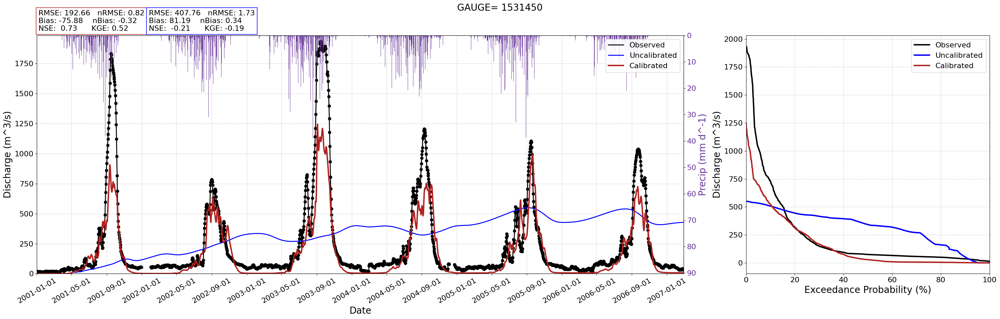

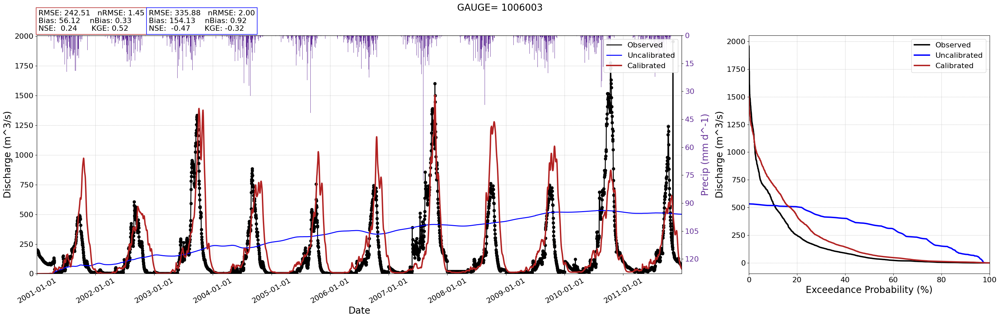

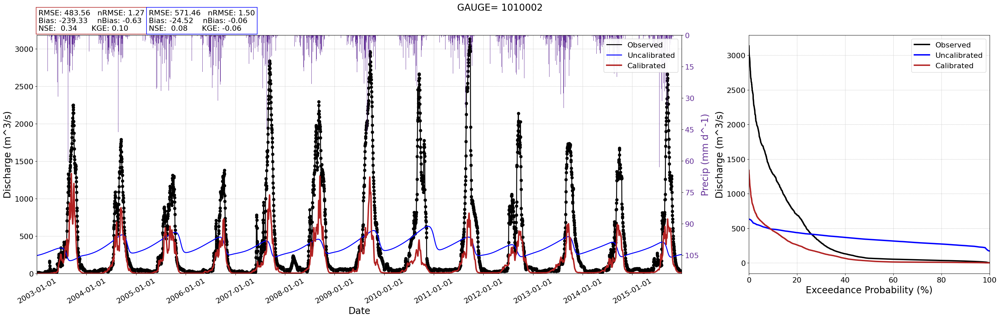

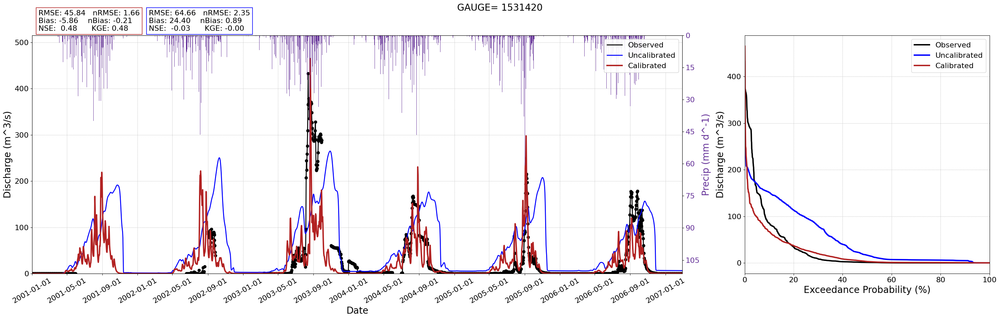

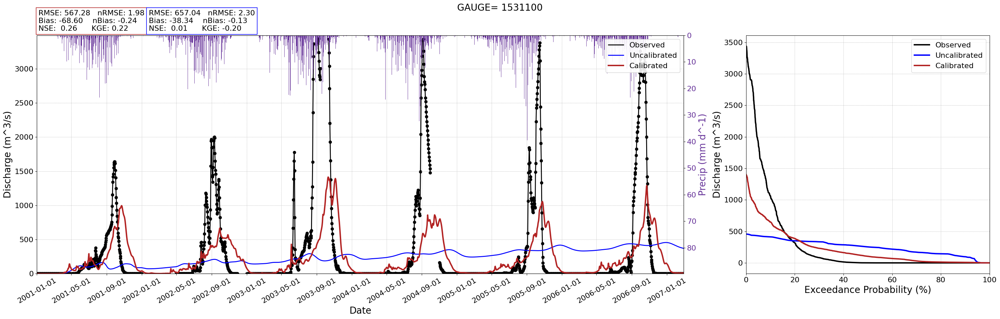

...

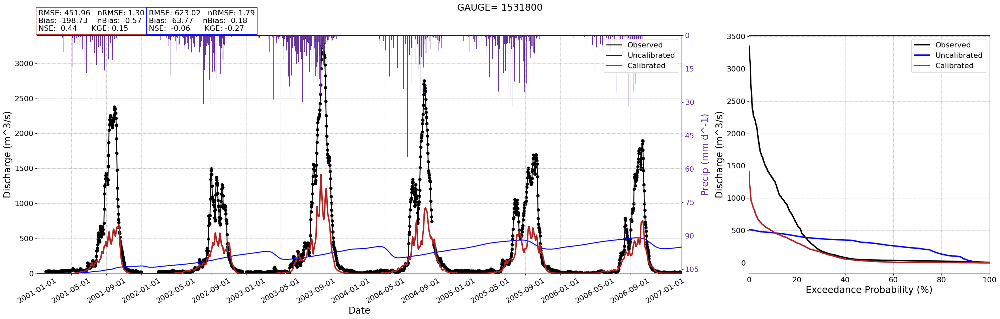

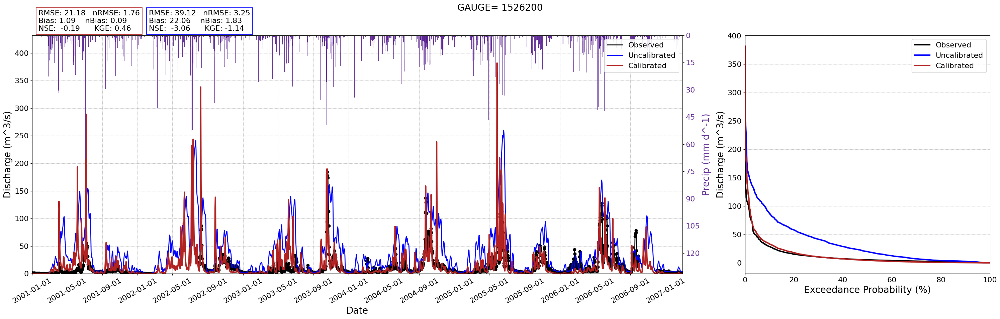

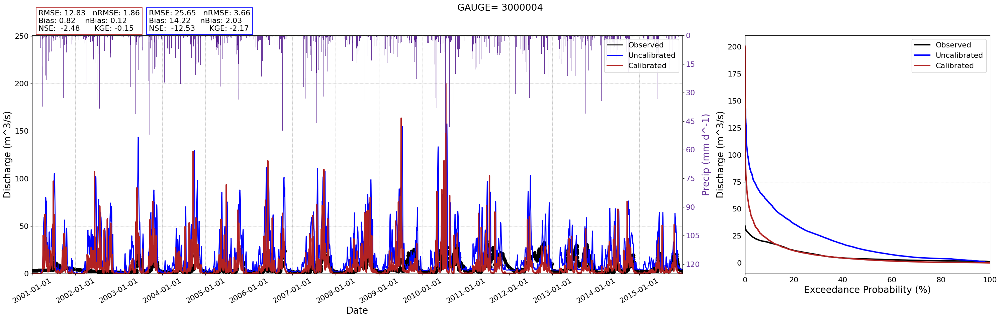

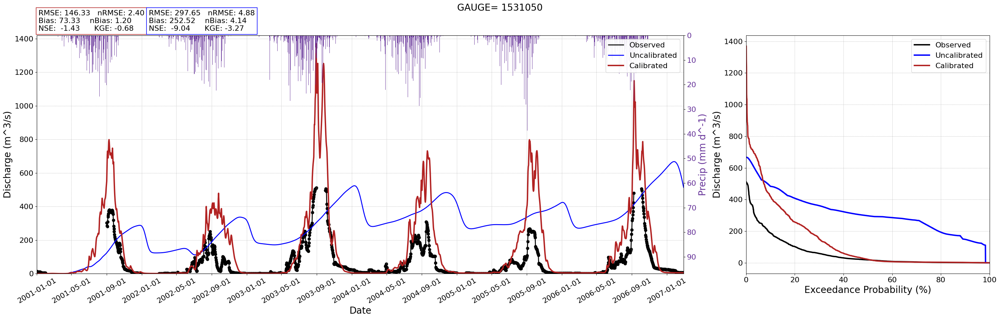

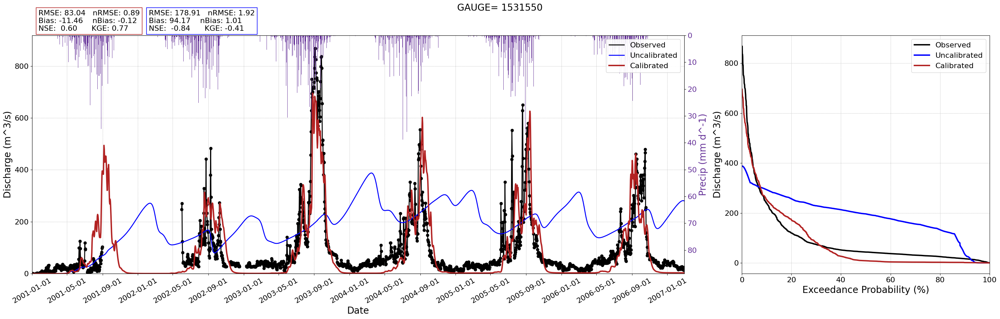

In [8]:
file_list_sim1 = glob.glob(sim_data_1+"dailyQ/" + "*.csv")
file_list_sim3 = glob.glob(sim_data_3+"dailyQ/" + "*.csv")

path_sim_data1 = sim_data_1+"dailyQ/"
file_list_sim1 = file_list_sim1
path_sim_data3 = sim_data_3+"dailyQ/"
file_list_sim3 = file_list_sim3

error_1 = pd.read_csv("./Baseline_Simulation/cal_baseline/error_m/error_metrics.csv", sep = ";")
error_1.set_index("gauge", inplace= True)
error_3 = pd.read_csv("./Calibrated_Baseline_Simulation/error_m/error_metrics.csv", sep =";")
error_3.set_index("gauge", inplace= True)

fdc_path1 = sim_data_1+"fdc/"
fdc_sim1 = glob.glob(fdc_path1 + "*.csv")
fdc_path3 = sim_data_3+"fdc/"
fdc_sim3 = glob.glob(fdc_path3 + "*.csv")

path_results = "./Results/"

for file_obs in file_list_obs:
    # Extract the number from the current file in observations
    num_file = file_obs[len(prefix_obs):-len('_daily_Q.csv')].strip()
    df_observed =  pd.read_csv(file_obs, parse_dates=['date'], index_col='date')
    df_observed = df_observed.rename_axis('Time')
    df_observed = df_observed[df_observed.index.year >= 2000]
    df_observed.rename(columns= {"discharge":"Q_obs"},inplace = True)
    matching_file_obs = None
    #Busco el archivo de la simulacion base (la 1):
    for file_1 in file_list_sim1:
        num_file_sim1 = file_1[len(path_sim_data1)+3:-len('.crest.csv')].strip()
        
        if num_file_sim1 == num_file:
            print('there is matching file in baseline 1:',num_file, num_file_sim1)
            #open and process simulation file
            ef5_file_1 = pd.read_csv(file_1, sep =',')
            ef5_file_1['Time'] =  pd.to_datetime(ef5_file_1['Time'])
            ef5_file_1 = ef5_file_1.set_index("Time")
            ef5_file_1.rename(columns= {"Discharge(m^3 s^-1)":"Discharge(m^3 s^-1)_1","Precip (mm d^-1)":"Precip (mm d^-1)_1"},inplace = True)
            break
    for file_3 in file_list_sim3:
        num_file_sim3 = file_3[len(path_sim_data3)+3:-len('.crest.csv')].strip()

        if num_file_sim3 == num_file:
            print('there is matching file in baseline 3:',num_file, num_file_sim3)
            ef5_file_3 = pd.read_csv(file_3, sep =',')
            ef5_file_3['Time'] =  pd.to_datetime(ef5_file_3['Time'])
            ef5_file_3 = ef5_file_3.set_index("Time")
            ef5_file_3.rename(columns= {"Discharge(m^3 s^-1)":"Discharge(m^3 s^-1)_3","Precip (mm d^-1)":"Precip (mm d^-1)_3"},inplace = True)
            break
    
    if not os.path.exists(path_results+"plots_daily/"):
        os.makedirs(path_results+"plots_daily/")
        
    #Open the fdc 
    for fdc_file3 in fdc_sim3:
        fdc_num = fdc_file3[len(fdc_path3):-len('_fdc.csv')].strip()
        if fdc_num == num_file:
            fdc_3 = pd.read_csv(fdc_file3, sep =';')

    for fdc_file1 in fdc_sim1:
        fdc_num1 = fdc_file1[len(fdc_path1):-len('_fdc.csv')].strip()
        if fdc_num1 == num_file:
            fdc_1 = pd.read_csv(fdc_file1, sep =';')
            
    #Plotting
    plotting(ef5_file_1, ef5_file_3, df_observed, num_file, fdc_3, fdc_1, error_3, error_1)



# Seasonal evaluation

In [44]:
def calculate_monthly_mean(df):
    """
    Calculate the monthly mean of each column in a DataFrame with a datetime index.
    """
    # Ensure the index is of datetime type
    if not pd.api.types.is_datetime64_any_dtype(df.index):
        raise ValueError("The DataFrame index must be of datetime type.")
    
    # Resample by month and calculate mean for each column
    monthly_mean = df.groupby(df.index.month).mean()

    return monthly_mean
    
def calculate_anual_error(df):    
    rmse = np.sqrt(mean_squared_error(df['discharge'],df['Discharge(m^3 s^-1)']))
    norm_rmse = (rmse / (df['discharge'].mean()))*100
    
    bias = (df['Discharge(m^3 s^-1)'] - df['discharge']).mean()
    norm_bias = (bias/ (df['discharge'].mean()))*100
    
    nse = 1 - ((df['Discharge(m^3 s^-1)'] - df['discharge']) ** 2).sum() / ((df['discharge'] - df['discharge'].mean()) ** 2).sum()

    # Modified Kling-Gupta Efficiency (KGE)
    r = np.corrcoef(df['Discharge(m^3 s^-1)'], df['discharge'])[0, 1]
    alpha = df['Discharge(m^3 s^-1)'].std() / df['discharge'].std()
    beta = df['Discharge(m^3 s^-1)'].mean() / df['discharge'].mean()
    kge = 1 - np.sqrt((r - 1)**2 + (alpha - 1)**2 + (beta - 1)**2)

    print("Anual Error Metrics Calculated")
    return {
        "RMSE": rmse,
        "Normalized RMSE": norm_rmse,
        "Bias": bias,
        "Normalized Bias": norm_bias,
        "NSE": nse,
        "Modified KGE": kge
    }

def calculate_monthly_errors(df_dayly):
    """
    This function is goint to calculate the monthly errors and correlation of monthly anomalies
    from the daily data 
    """
        ##Time series of errors 
    # Initialize lists to store errors
    rmse_mensual = []
    bias_mensual = []
    nse_mensual = []
    corr_mensual = []
    meses = range(1, 13)

    for mes in meses:
        datos_mes = df_dayly[df_dayly.index.month == mes]

        obs = datos_mes['discharge'].values
        sim = datos_mes['Discharge(m^3 s^-1)'].values
        
        #calculate RMSE
        rmse = np.sqrt(np.mean((sim - obs) ** 2))
        # rmse_n = (rmse/ np.mean(obs)) *100
        rmse_mensual.append(rmse)

        # Calculate Bias
        bias_ts = (sim - obs).mean()#/obs
        # bias_n = (bias_ts/np.mean(obs)) *100
        bias_mensual.append(bias_ts)

        # Calcular NSE
        if np.var(obs) != 0:
            nse = 1 - np.sum((sim - obs) ** 2) / np.sum((obs - np.mean(obs)) ** 2)
            if nse < -1:
                nse = -1
        else:
            nse = np.nan  # Asignar NaN si la varianza de obs es cero
        nse_mensual.append(nse)

        #anomalies
        mean_obs = obs.mean()
        mean_sim = sim.mean()

        anomalies_sim = mean_sim - obs
        anomalies_obs= mean_obs - sim

        corr, _ = pearsonr(anomalies_obs, anomalies_sim)
        corr_mensual.append(corr)

    # Build a DataFrame with results
    error_df = pd.DataFrame({
        'rmse_n': rmse_mensual,
        'bias_n': bias_mensual,
        'nse': nse_mensual,
        'anom_pear_corr': corr_mensual
    }, index=meses)

    return error_df
    
def monthly_anomalies_df(dataframe):
    mean_obs = dataframe['discharge'].mean()
    mean_sim = dataframe['Discharge(m^3 s^-1)'].mean()

    dataframe['anomalies_sim'] = mean_sim - dataframe['Discharge(m^3 s^-1)']
    dataframe['anomalies_obs'] = mean_obs - dataframe['discharge']

    return dataframe

In [149]:
def monthly_plotting(ax1, dataframe_s1, anual_error_sim1, dataframe_s3, anual_error_sim3, gauge_number):
    """
    Plot observed and simulated monthly discharge along with precipitation on a secondary y-axis.
    """
    ax1.scatter(dataframe_s1.index, dataframe_s1['discharge'], color='black', label='Observed', s=70)
    ax1.plot(dataframe_s1.index, dataframe_s1['discharge'], color='black', linewidth=2)
    ax1.plot(dataframe_s1.index, dataframe_s1['Discharge(m^3 s^-1)'], color='blue', label='Uncalibrated', linewidth=3)
    ax1.plot(dataframe_s3.index, dataframe_s3['Discharge(m^3 s^-1)'], color='firebrick', label='Calibrated', linewidth=3)

    ax1.set_xlabel('Month', fontsize=20)
    ax1.set_ylabel('Mean Discharge (m^3/s)', fontsize=20, color='black')
    ax1.tick_params(axis='y', labelcolor='black', labelsize=16)
    ax1.set_xlim(dataframe_s1.index.values[0], dataframe_s1.index.values[-1])
    ax1.set_xticks(dataframe_s1.index)
    
    month_names = ['January', 'February', 'March', 'April', 'May', 'June',
                   'July', 'August', 'September', 'October', 'November', 'December']
    ax1.set_xticklabels(month_names, fontsize=16, rotation=30)
    ax1.grid(True, which='major', linestyle='--', linewidth=0.5)
    ax1.set_ylim(0, dataframe_s3['Discharge(m^3 s^-1)'].max() + 100)

    # Secondary axis for precipitation
    ax2 = ax1.twinx()
    ax2.bar(dataframe_s1.index, dataframe_s1['Precip (mm d^-1)'], color='rebeccapurple', linewidth=2, alpha=0.9)
    ax2.set_ylim(0, dataframe_s1['Precip (mm d^-1)'].max() + 100)
    ax2.invert_yaxis()
    ax2.set_ylabel('Precip (mm d^-1)', color='rebeccapurple', fontsize=20)
    ax2.tick_params(axis='y', labelcolor='rebeccapurple', labelsize=16)

    # Metrics box
    ax1.text(0.01, 0.97, 
             f"RMSE: {anual_error_sim1['RMSE']:.2f}\nBias: {anual_error_sim1['Bias']:.2f}\n%RMSE: {anual_error_sim1['Normalized Bias']:.2f}\n%Bias: {anual_error_sim1['Normalized RMSE']:.2f}\nNSE: {anual_error_sim1['NSE']:.2f}\nKGE: {anual_error_sim1['Modified KGE']:.2f}",
             transform=ax1.transAxes, fontsize=14, verticalalignment='top',
             bbox=dict(boxstyle='round', facecolor='white', alpha=0.9, edgecolor='blue', linewidth=1.2))
    ax1.text(0.15, 0.97, 
         f"RMSE: {anual_error_sim3['RMSE']:.2f}\nBias: {anual_error_sim3['Bias']:.2f}\n%RMSE: {anual_error_sim3['Normalized Bias']:.2f}\n%Bias: {anual_error_sim3['Normalized RMSE']:.2f}\nNSE: {anual_error_sim3['NSE']:.2f}\nKGE: {anual_error_sim3['Modified KGE']:.2f}",
         transform=ax1.transAxes, fontsize=14, verticalalignment='top',
         bbox=dict(boxstyle='round', facecolor='white', edgecolor='firebrick', linewidth=1.2, alpha=0.9)) 

    ax1.legend(loc='upper right', fontsize=16)
    ax1.set_title('GAUGE= ' + gauge_number, fontsize=20)

def plot_monthly_errors(df_errors_1, df_errors_3, axs):
    """
    Plot RMSE, Bias, and Anomaly Correlation using externally provided axes.
    """
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    # Plot RMSE
    axs[0].plot(df_errors_1.index, df_errors_1['rmse_n'], marker='o', color='salmon', linewidth=3, alpha=0.8, label='Uncalibrated')
    axs[0].plot(df_errors_3.index, df_errors_3['rmse_n'], marker='o', color='red', linewidth=3, alpha=1, label='Calibrated')
    axs[0].legend(loc='upper right',fontsize=16)
    axs[0].set_ylabel('RMSE', fontsize=16)
    axs[0].grid(True)
    axs[0].set_xticks(df_errors_1.index)
    axs[0].set_xticklabels(month_names, rotation=0, fontsize=12)

    # Plot Bias
    axs[1].plot(df_errors_1.index, df_errors_1['bias_n'], marker='o', color='lightgreen', linewidth=3, alpha=0.8,label='Uncalibrated')
    axs[1].plot(df_errors_3.index, df_errors_3['bias_n'], marker='o', color='green', linewidth=3, alpha=1, label='Calibrated')
    axs[1].legend(loc='upper right',fontsize=16)
    axs[1].set_ylabel('Bias', fontsize=16)
    axs[1].grid(True)
    axs[1].set_xticks(df_errors_1.index)
    axs[1].set_xticklabels(month_names, rotation=0, fontsize=12)
    
    # Plot Anomaly Pearson Correlation
    axs[2].plot(df_errors_1.index, df_errors_1['anom_pear_corr'], marker='o', color='cornflowerblue', linewidth=3, linestyle='--', alpha=0.8,label='Uncalibrated')
    axs[2].plot(df_errors_3.index, df_errors_3['anom_pear_corr'], marker='o', color='blue', linewidth=3, linestyle='--', alpha=1, label='Calibrated')
    axs[2].axhline(y=0, color='black', linewidth=1)
    axs[2].set_ylabel('R of monthly anomalies', fontsize=14)
    axs[2].legend(loc='upper right',fontsize=16)
    axs[2].set_xlabel('Month', fontsize=16)
    axs[2].grid(True)
    # Set x-tick labels to month names on the last subplot
    axs[2].set_xticks(df_errors_1.index)
    axs[2].set_xticklabels(month_names, rotation=0, fontsize=12)

def plot_anomaly_dispersion(df_anom1, df_anom3, ax1, ax2):
    """
    Plots the dispersion of anomalies between simulated and observed data on provided axes.
    
    Parameters:
        df (pd.DataFrame): Contains 'anomalies_sim', 'anomalies_obs', and optionally 'month'.
        ax1, ax2 (matplotlib.axes): Axes to draw the scatter and box plots.
        file (str): Filename used to extract gauge info.
        prefix (str): Prefix used to clean the filename.
    """

    anomalies_sim1 = df_anom1['anomalies_sim']
    anomalies_obs1 = df_anom1['anomalies_obs']
    corr1, _ = pearsonr(anomalies_obs1, anomalies_sim1)
    anomalies_sim3 = df_anom3['anomalies_sim']
    anomalies_obs3 = df_anom3['anomalies_obs']
    corr3, _ = pearsonr(anomalies_obs3, anomalies_sim3)
    

    # Add month column if not present
    if 'month' not in df_anom1.columns:
        df_anom1.loc[:, 'month'] = np.arange(1, len(df_anom1) + 1)

    # Set up colors
    cmap = sns.color_palette("Paired", 12)
    colors = [cmap[month - 1] for month in df_anom1['month']]

    # Scatter plot
    ax1.scatter(anomalies_sim1, anomalies_obs1, color=colors, marker='^', s=100, alpha=1)
    ax1.scatter(anomalies_sim3, anomalies_obs3, color=colors, s=130, alpha=1)
    ax1.set_xlabel('Simulated Anomalies', fontsize=14)
    ax1.set_ylabel('Observed Anomalies', fontsize=14)
    ax1.set_title('Correlation of Monthly Anomalies', fontsize=16)
    ax1.grid(True)
    lims = [
    min(ax1.get_xlim()[0], ax1.get_ylim()[0]),  # min of both axes
    max(ax1.get_xlim()[1], ax1.get_ylim()[1]),  # max of both axes
    ]
    ax1.plot(lims, lims, '--', color='black', linewidth=1, alpha = 0.7)  # dashed 1:1 line
    ax1.set_xlim(lims)
    ax1.set_ylim(lims)

    # Month legend
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']  # ['Jan', 'Feb', ..., 'Dec']
    handles = [plt.Line2D([0], [0], marker='o', color='w',
                          markerfacecolor=cmap[i], markersize=10) for i in range(12)]
    ax1.legend(handles, month_names, title="Months", bbox_to_anchor=(1.0, 1.01), loc='upper left')

    ax1.text(0.02, 0.97, f"$▲ R_{{uncal}} = {corr1:.2f}$", transform=ax1.transAxes, fontsize=16,
             verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))
    
    ax1.text(0.02, 0.90, f"$● R_{{cal}} = {corr3:.2f}$", transform=ax1.transAxes, fontsize=16,
             verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.9))



    # Box plot
    ax2.boxplot([anomalies_sim1,anomalies_sim3, anomalies_obs1],
                labels=['Uncalibrated', 'Calibrated','Observed'],
                patch_artist=True,
                boxprops=dict(facecolor='lightblue'))
    ax2.set_ylabel('Anomalies', fontsize=14)
    ax2.set_title('Dispersion of Monthly Anomalies', fontsize=16)
    ax2.grid(True)

In [37]:
#data
sim_data_1 = './Baseline_Simulation/cal_baseline/dailyQ/'
sim_data_3 = './Calibrated_Baseline_Simulation/dailyQ/'
obs_path = './consolidated/'
path_results = './Results/'

file_list_obs = glob.glob(obs_path + "*.csv")
file_list_sim1 = glob.glob(sim_data_1 + "*.csv")
file_list_sim3 = glob.glob(sim_data_3 + "*.csv")

looking for files in gauge:  1531450
there is matching file for simulation 1: 1531450 1531450
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531450 1531450
Anual Error Metrics Calculated


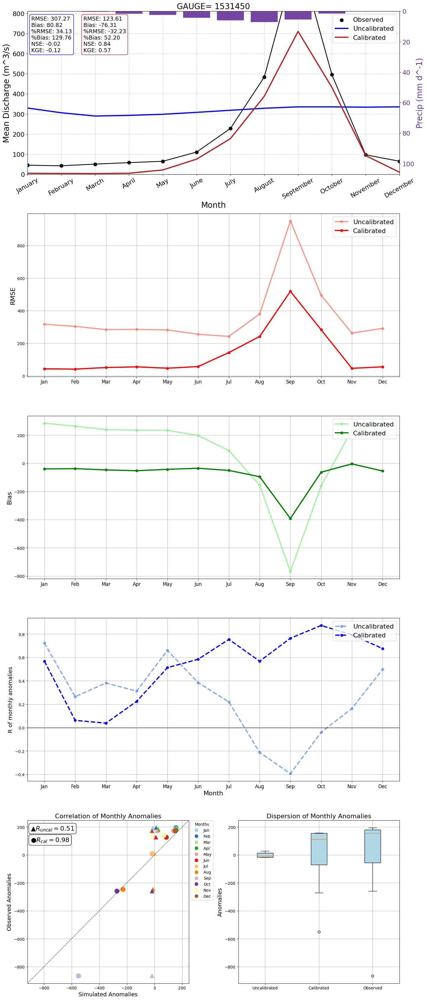

looking for files in gauge:  1006003
there is matching file for simulation 1: 1006003 1006003
Anual Error Metrics Calculated
there is matching file for simulation 3: 1006003 1006003
Anual Error Metrics Calculated


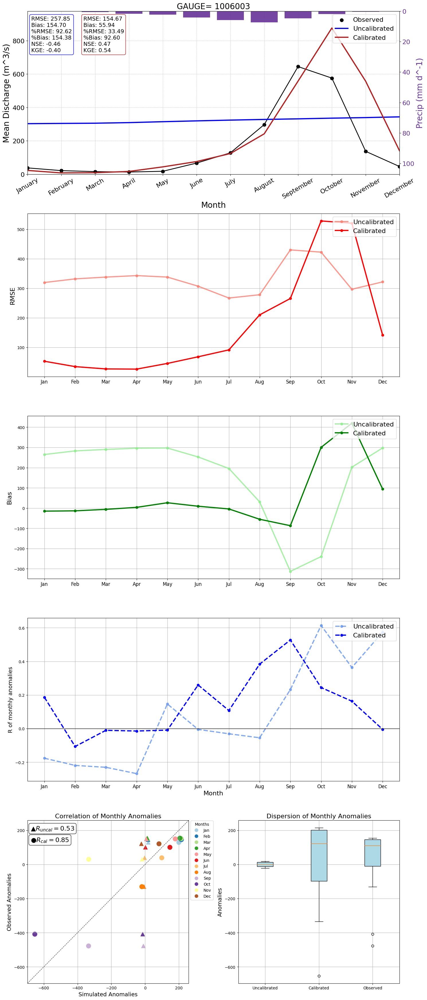

looking for files in gauge:  1010002
there is matching file for simulation 1: 1010002 1010002
Anual Error Metrics Calculated
there is matching file for simulation 3: 1010002 1010002
Anual Error Metrics Calculated


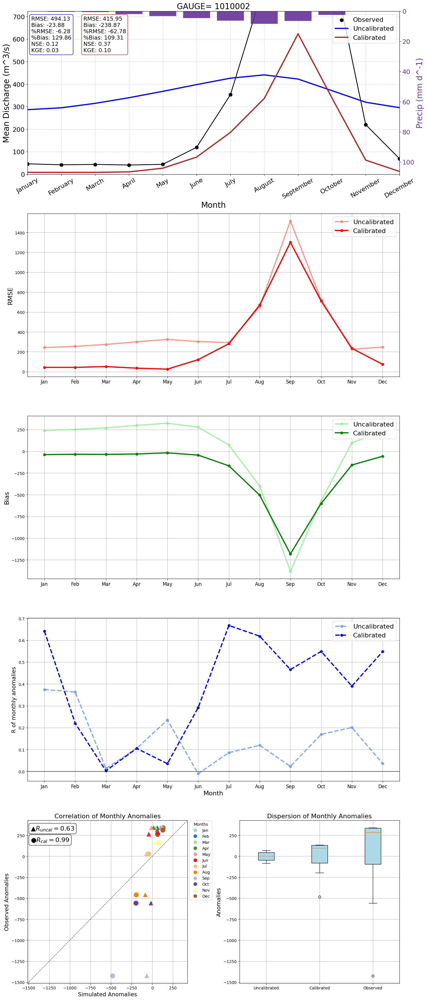

looking for files in gauge:  1531420
there is matching file for simulation 1: 1531420 1531420
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531420 1531420
Anual Error Metrics Calculated


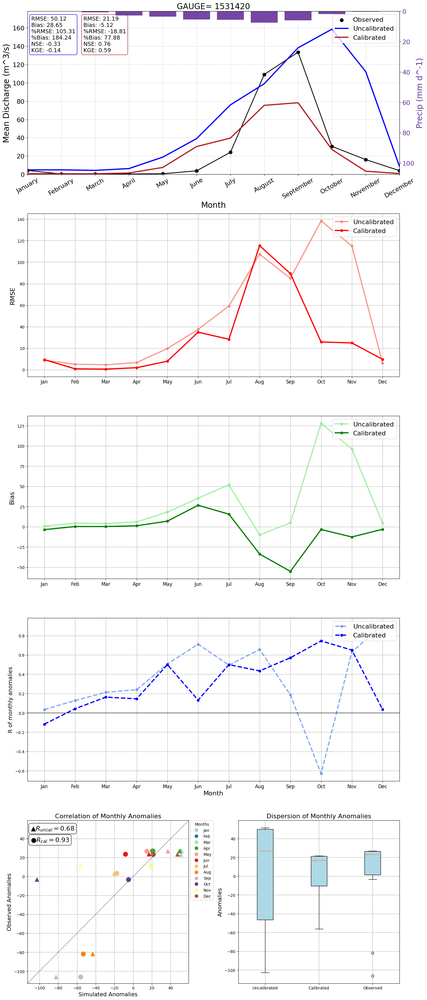

looking for files in gauge:  1531100
there is matching file for simulation 1: 1531100 1531100
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531100 1531100
Anual Error Metrics Calculated


/usr/local/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4427: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4427: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


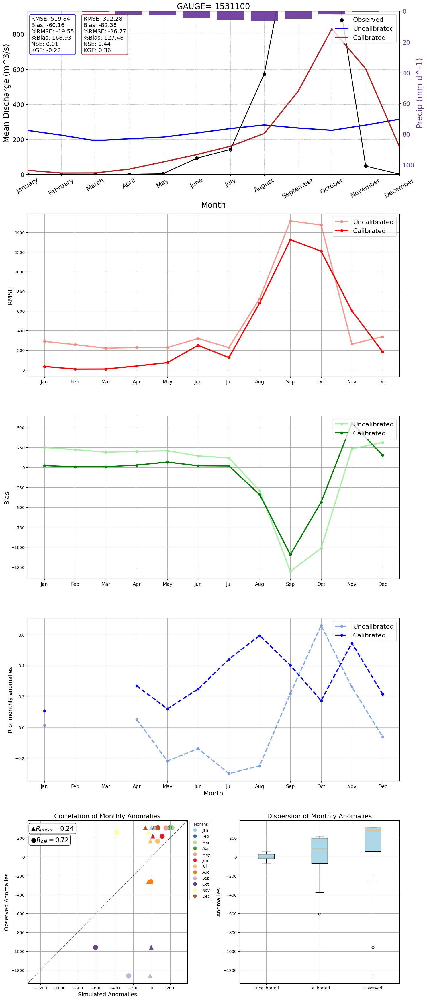

looking for files in gauge:  1531430
there is matching file for simulation 1: 1531430 1531430
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531430 1531430
Anual Error Metrics Calculated


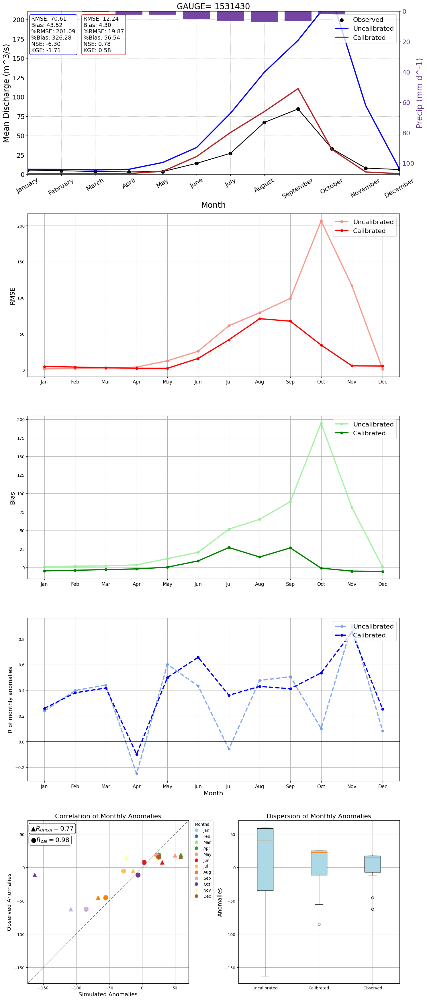

looking for files in gauge:  1531600
there is matching file for simulation 1: 1531600 1531600
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531600 1531600
Anual Error Metrics Calculated


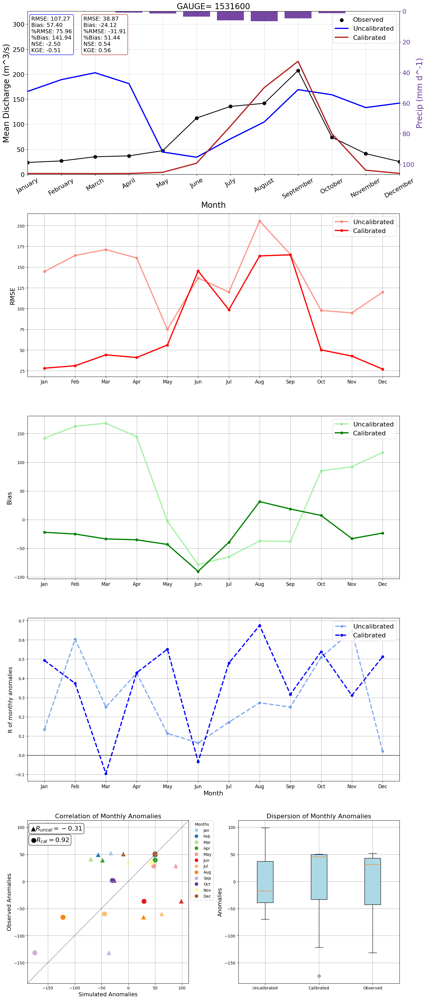

looking for files in gauge:  1006007
there is matching file for simulation 1: 1006007 1006007
Anual Error Metrics Calculated
there is matching file for simulation 3: 1006007 1006007
Anual Error Metrics Calculated


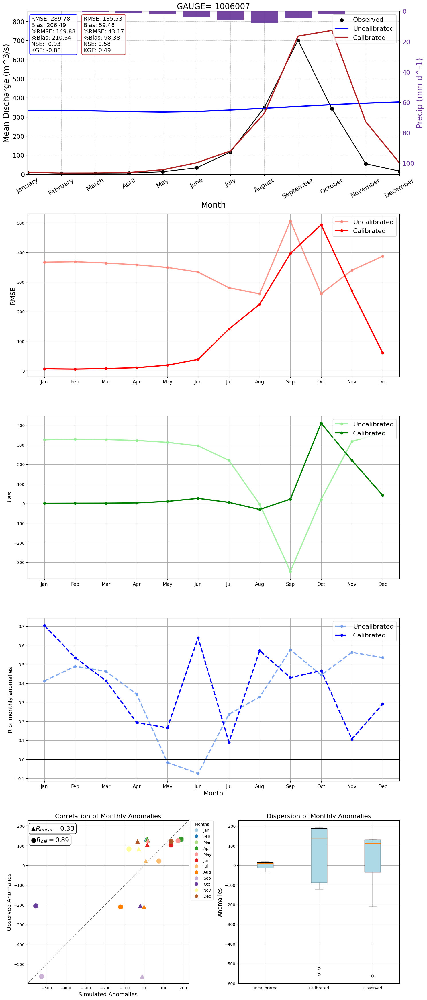

looking for files in gauge:  9000005
there is matching file for simulation 1: 9000005 9000005
Anual Error Metrics Calculated
there is matching file for simulation 3: 9000005 9000005
Anual Error Metrics Calculated


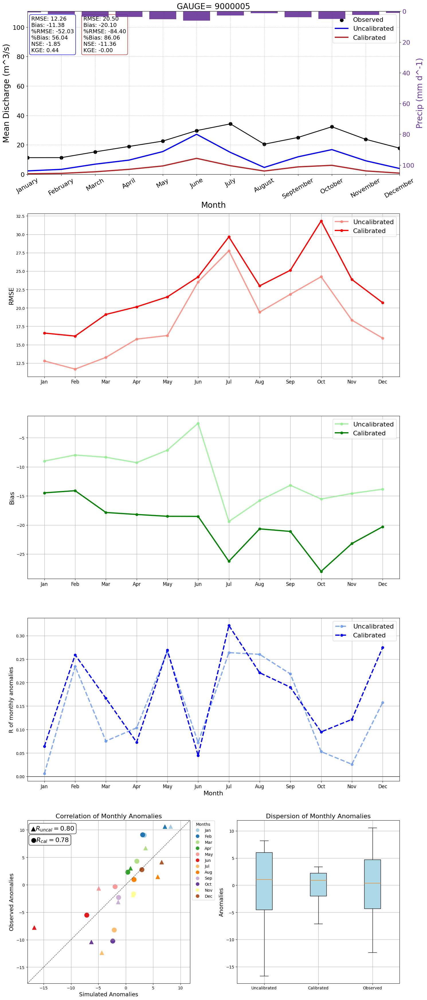

looking for files in gauge:  1531300
there is matching file for simulation 1: 1531300 1531300
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531300 1531300
Anual Error Metrics Calculated


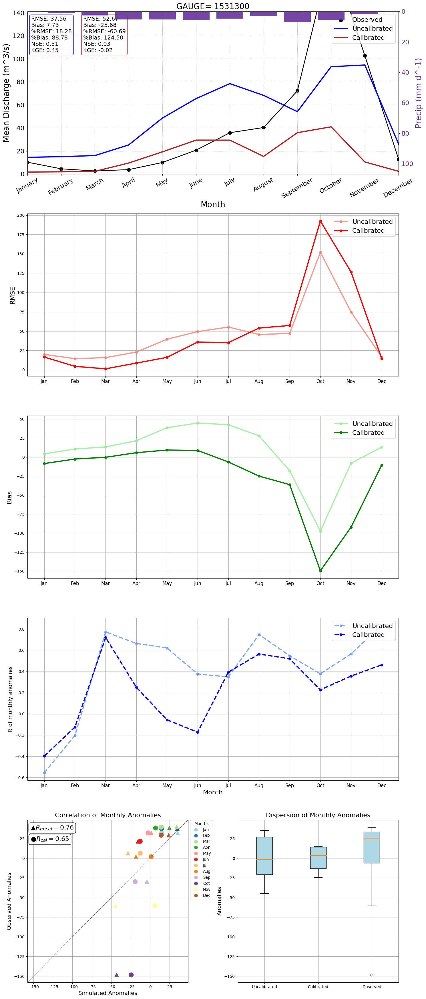

looking for files in gauge:  1526300
there is matching file for simulation 1: 1526300 1526300
Anual Error Metrics Calculated
there is matching file for simulation 3: 1526300 1526300
Anual Error Metrics Calculated


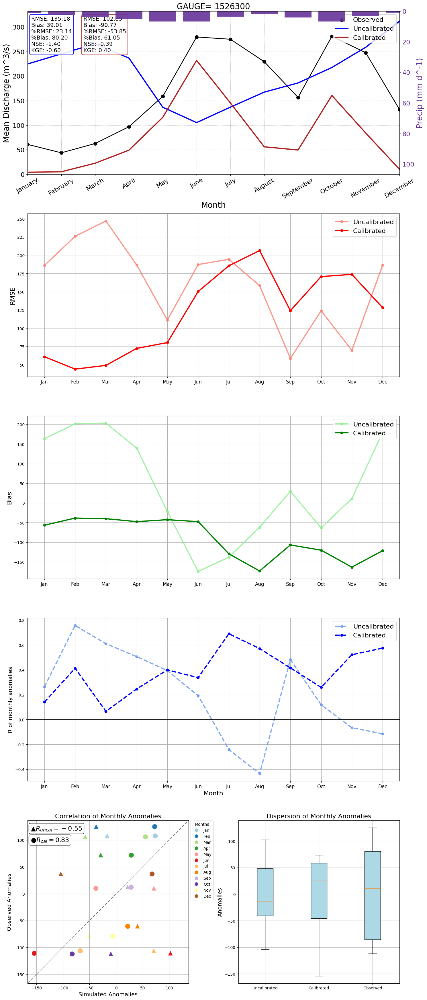

looking for files in gauge:  3000003
there is matching file for simulation 1: 3000003 3000003
Anual Error Metrics Calculated
there is matching file for simulation 3: 3000003 3000003
Anual Error Metrics Calculated


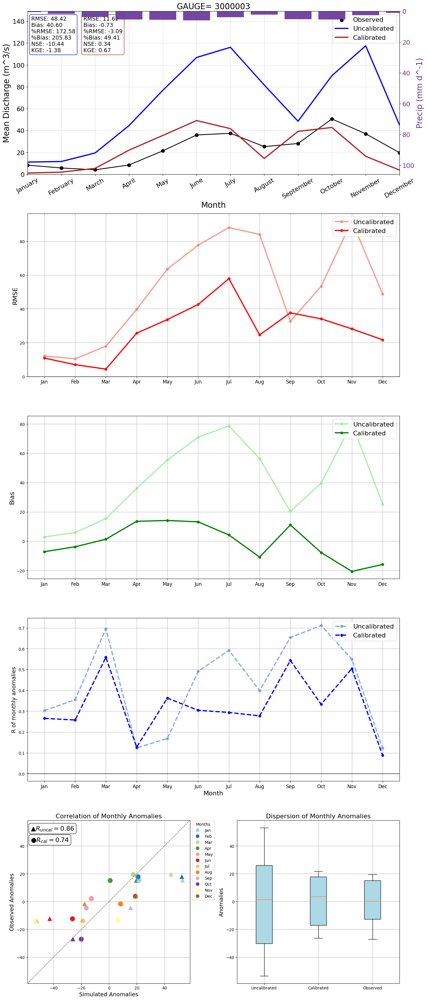

looking for files in gauge:  1531650
there is matching file for simulation 1: 1531650 1531650
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531650 1531650
Anual Error Metrics Calculated


/usr/local/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4427: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/usr/local/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4427: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


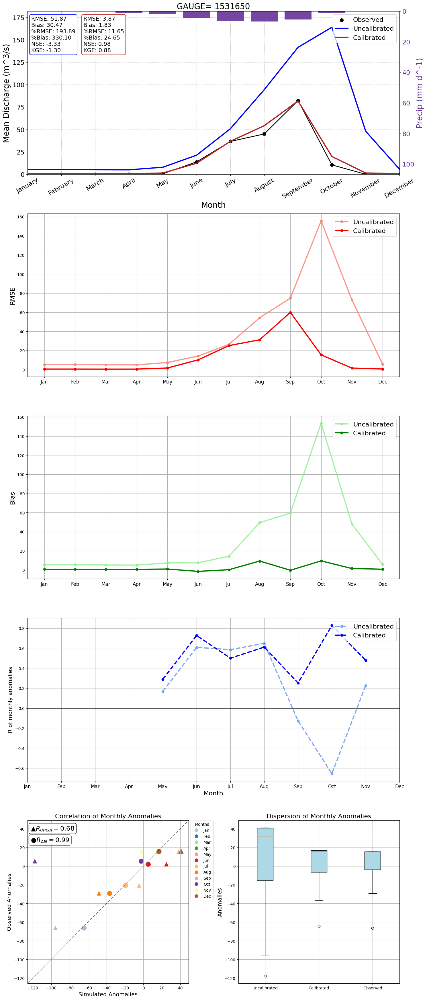

looking for files in gauge:  5000001
there is matching file for simulation 1: 5000001 5000001
Anual Error Metrics Calculated
there is matching file for simulation 3: 5000001 5000001
Anual Error Metrics Calculated


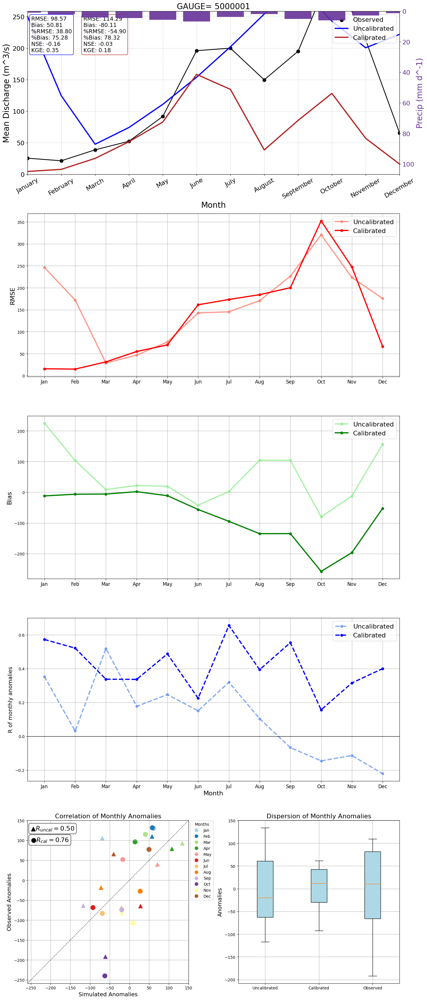

looking for files in gauge:  9000008
there is matching file for simulation 1: 9000008 9000008
Anual Error Metrics Calculated
there is matching file for simulation 3: 9000008 9000008
Anual Error Metrics Calculated


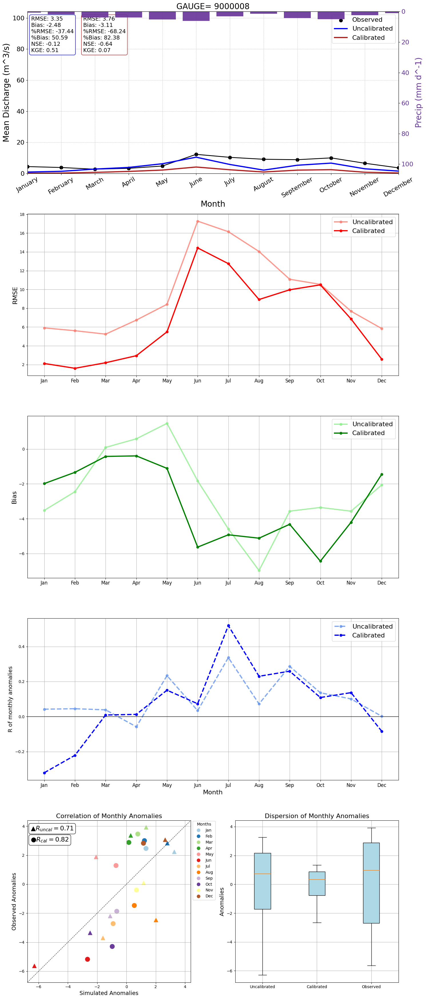

looking for files in gauge:  1531800
there is matching file for simulation 1: 1531800 1531800
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531800 1531800
Anual Error Metrics Calculated


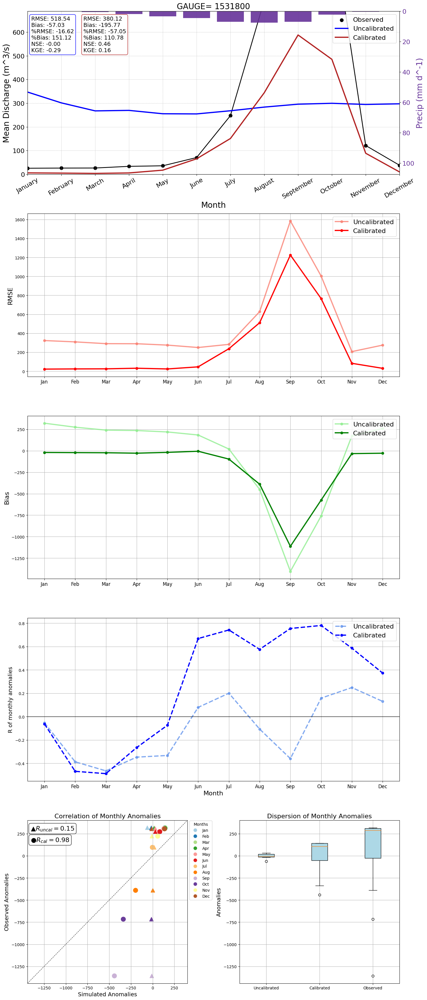

looking for files in gauge:  1526200
there is matching file for simulation 1: 1526200 1526200
Anual Error Metrics Calculated
there is matching file for simulation 3: 1526200 1526200
Anual Error Metrics Calculated


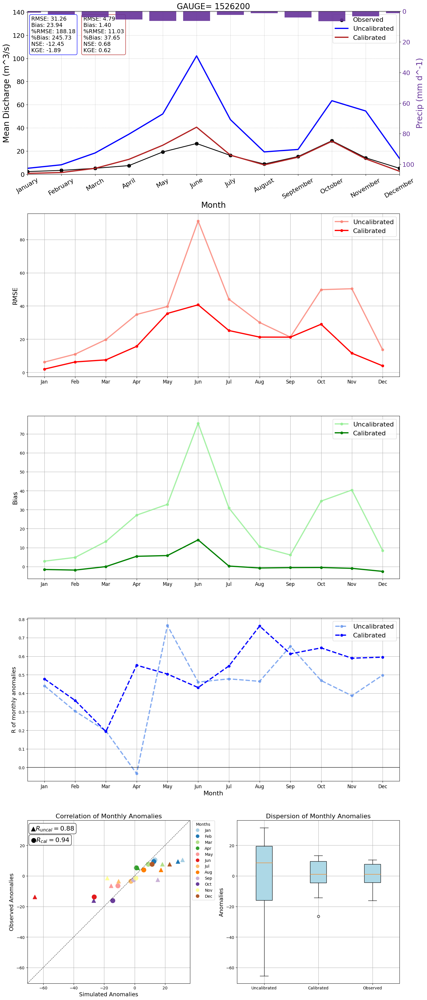

looking for files in gauge:  3000004
there is matching file for simulation 1: 3000004 3000004
Anual Error Metrics Calculated
there is matching file for simulation 3: 3000004 3000004
Anual Error Metrics Calculated


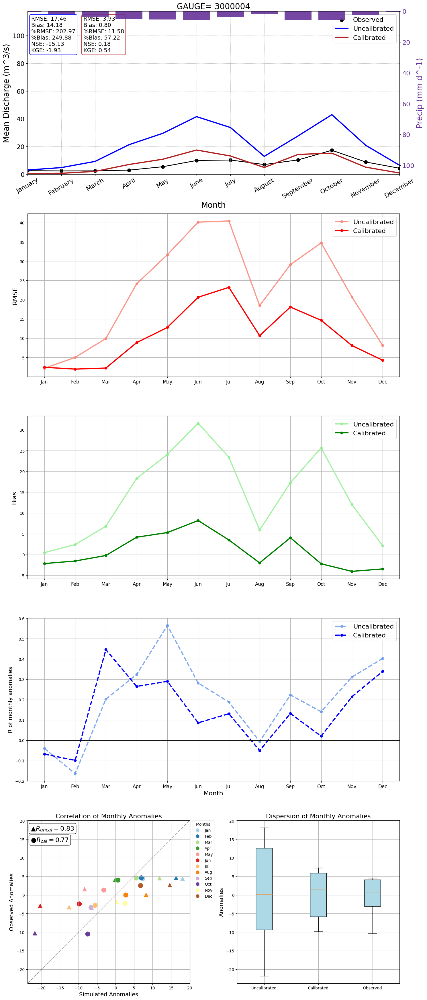

looking for files in gauge:  1531050
there is matching file for simulation 1: 1531050 1531050
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531050 1531050
Anual Error Metrics Calculated


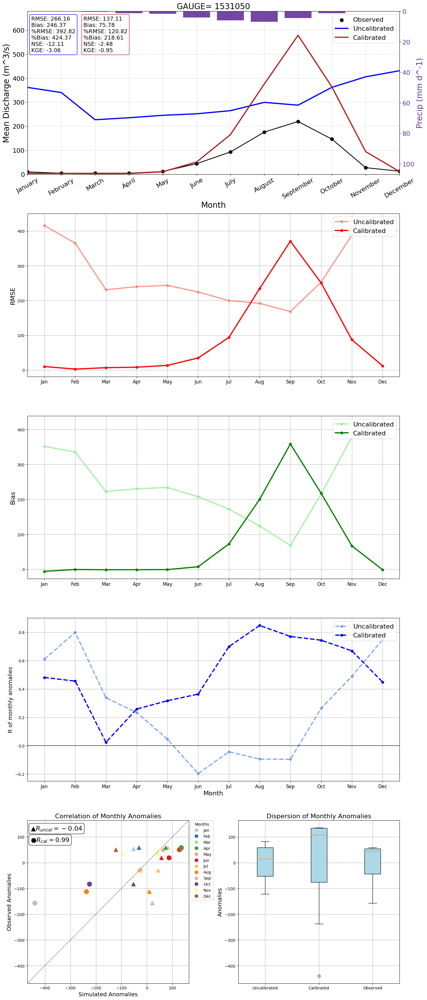

looking for files in gauge:  1531550
there is matching file for simulation 1: 1531550 1531550
Anual Error Metrics Calculated
there is matching file for simulation 3: 1531550 1531550
Anual Error Metrics Calculated


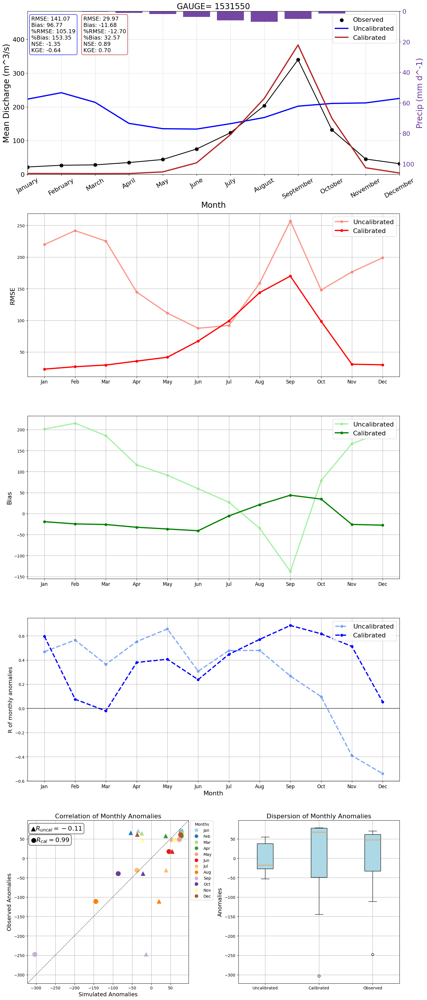

In [152]:
for file_obs in file_list_obs:
    # Extract the number from the current file
    num_file = file_obs[len(obs_path):-len('_daily_Q.csv')].strip()
    Q_obs = pd.read_csv(file_obs, sep =',', usecols = ['date','discharge'])
    Q_obs.rename(columns={"date":"Time"}, inplace=True)
    Q_obs['Time'] =  pd.to_datetime(Q_obs['Time'])
    Q_obs.set_index('Time',inplace=True)

    print('looking for files in gauge: ',num_file)
    #process simulation1.
    for file_sim1 in file_list_sim1:
        num_file_s1 = file_sim1[len(sim_data_1)+3:-len('.crest.csv')].strip()
        matching_file_obs = None
        
        if num_file_s1 == num_file:
            print('there is matching file for simulation 1:',num_file, num_file_s1)
            #abro el archivo y le quito los primeros meses (el warmup)
            Q_daily_df = pd.read_csv(file_sim1, sep =',', usecols = ['Time','Discharge(m^3 s^-1)','Precip (mm d^-1)'])
            Q_daily_df['Time'] =  pd.to_datetime(Q_daily_df['Time'])
            Q_daily_df.set_index('Time', inplace=True)
            
            merged_df = pd.concat([Q_daily_df, Q_obs], axis=1, join="inner")
            merged_df2 = merged_df.dropna()
            #primero se calcula el monthly mean
            monthly_mean_sim1 = calculate_monthly_mean(merged_df2)
            #calculate the errors where error_df is the timeseries of the normalized error
            anual_error_sim1 = calculate_anual_error(monthly_mean_sim1)
            #calculate the mean precip 
            error_df_sim1 = calculate_monthly_errors(merged_df2)
            #Then we calculate the anomalies and the coeff pearson of the anomalies
            montly_anom_sim1 = monthly_anomalies_df(monthly_mean_sim1)
            
            break
            #now we look for the same station in baseline 3
    for file_sim3 in file_list_sim3:
        num_file_s3 = file_sim3[len(sim_data_3)+3:-len('.crest.csv')].strip()
        matching_file_obs = None
        
        if num_file_s3 == num_file:
            print('there is matching file for simulation 3:',num_file, num_file_s3)
            #abro el archivo y le quito los primeros meses (el warmup)
            Q_daily_df3 = pd.read_csv(file_sim3, sep =',', usecols = ['Time','Discharge(m^3 s^-1)','Precip (mm d^-1)'])
            Q_daily_df3['Time'] =  pd.to_datetime(Q_daily_df3['Time'])
            Q_daily_df3.set_index('Time', inplace=True)

            
            merged_df3 = pd.concat([Q_daily_df3, Q_obs], axis=1, join="inner")
            merged_df3 = merged_df3.dropna()
            #primero se calcula el monthly mean
            monthly_mean_sim3 = calculate_monthly_mean(merged_df3)
            #calculate the errors where error_df is the timeseries of the normalized error
            anual_error_sim3 = calculate_anual_error(monthly_mean_sim3)
            #calculate the mean precip 
            error_df_sim3 = calculate_monthly_errors(merged_df3)
            #Then we calculate the anomalies and the coeff pearson of the anomalies
            montly_anom_sim3 = monthly_anomalies_df(monthly_mean_sim3)
            break
    if not os.path.exists(path_results+"plots_seasonal/"):
        os.makedirs(path_results+"plots_seasonal/")
        
    #Creathe a figure with 5 rows 2 columns 
    #Creathe a figure with 5 rows 2 columns 
    fig = plt.figure(figsize=(15,35))
    gs = gridspec.GridSpec(nrows=5, ncols=2, width_ratios=[1.2, 1.2])  # First two columns for ax1, last one for ax2
    
    ax1 = fig.add_subplot(gs[0, 0:2])
    ax2 = fig.add_subplot(gs[1, 0:2])
    ax3 = fig.add_subplot(gs[2, 0:2])
    ax4 = fig.add_subplot(gs[3, 0:2])
    ax5 = fig.add_subplot(gs[4, 0:1])
    ax6 = fig.add_subplot(gs[4, 1:2])
    monthly_plotting(ax1, monthly_mean_sim1, anual_error_sim1, monthly_mean_sim3, anual_error_sim3, num_file)
    # #plot the time series of errors 
    plot_monthly_errors(error_df_sim1, error_df_sim3, [ax2, ax3, ax4])
    #Plot the anomalies:
    plot_anomaly_dispersion(montly_anom_sim1,montly_anom_sim3, ax5, ax6)
    
    fig.tight_layout()
    #fig.savefig(path_results+"plots_seasonal/" + num_file + '_seasonal.pdf', bbox_inches='tight')
    #plt.close(fig)
    plt.show()